### ノック81：画像データを読み込んでみよう

画像幅：1920
画像高さ：1440


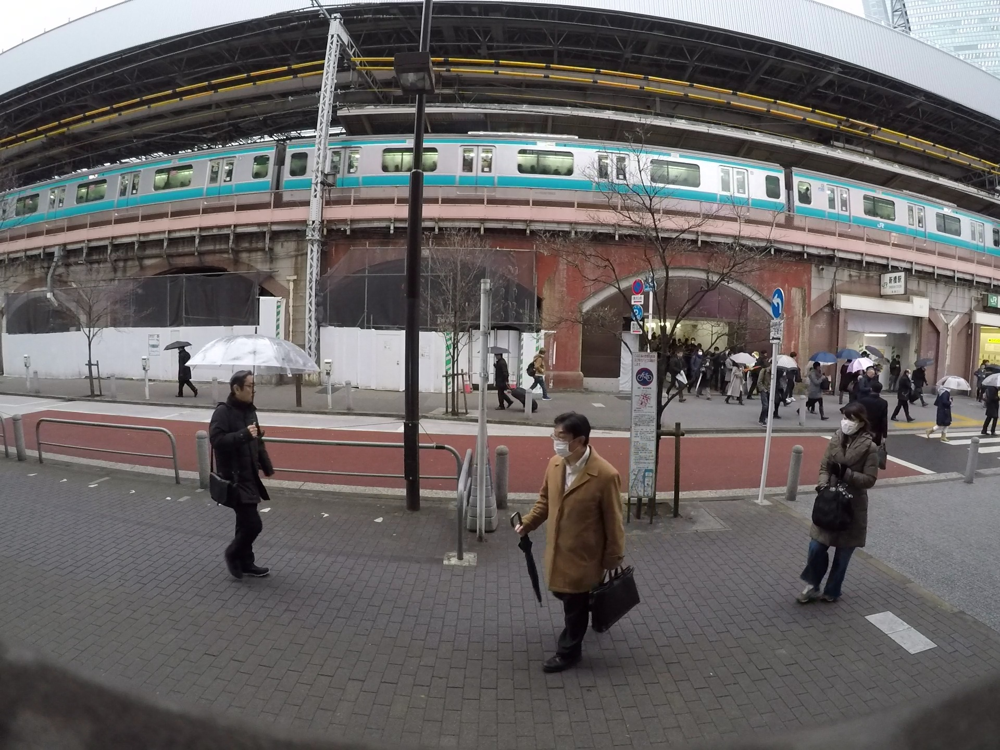

-1

In [1]:
import cv2
from google.colab.patches import cv2_imshow
img = cv2.imread('img01.jpg')
height, width = img.shape[:2]
print('画像幅：' + str(width))
print('画像高さ：' + str(height))
cv2_imshow(img)
cv2.waitKey(0)

### ノック82：映像データを読み込んでみよう

画像幅：1920.0
画像高さ：1440.0
総フレーム数：401.0
FPS：30.0


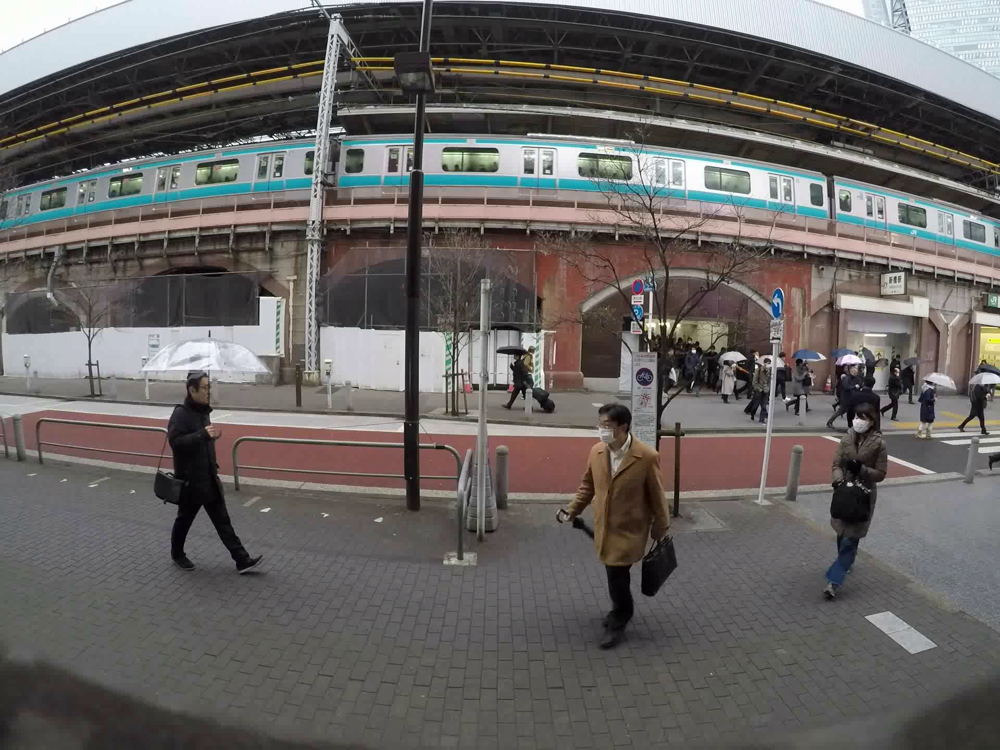

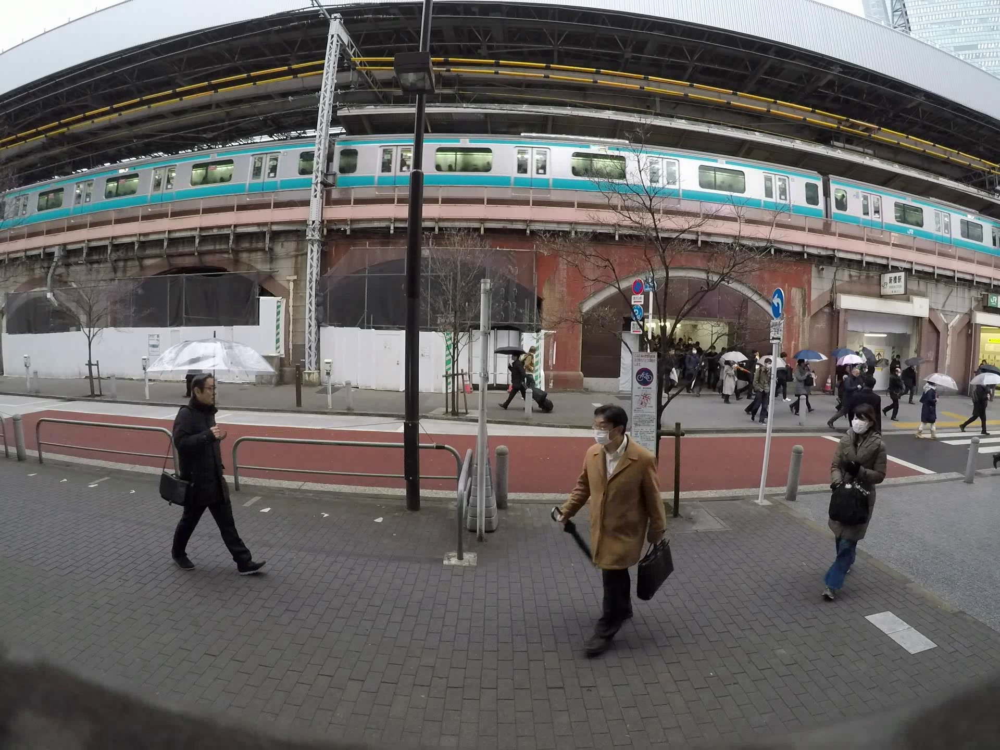

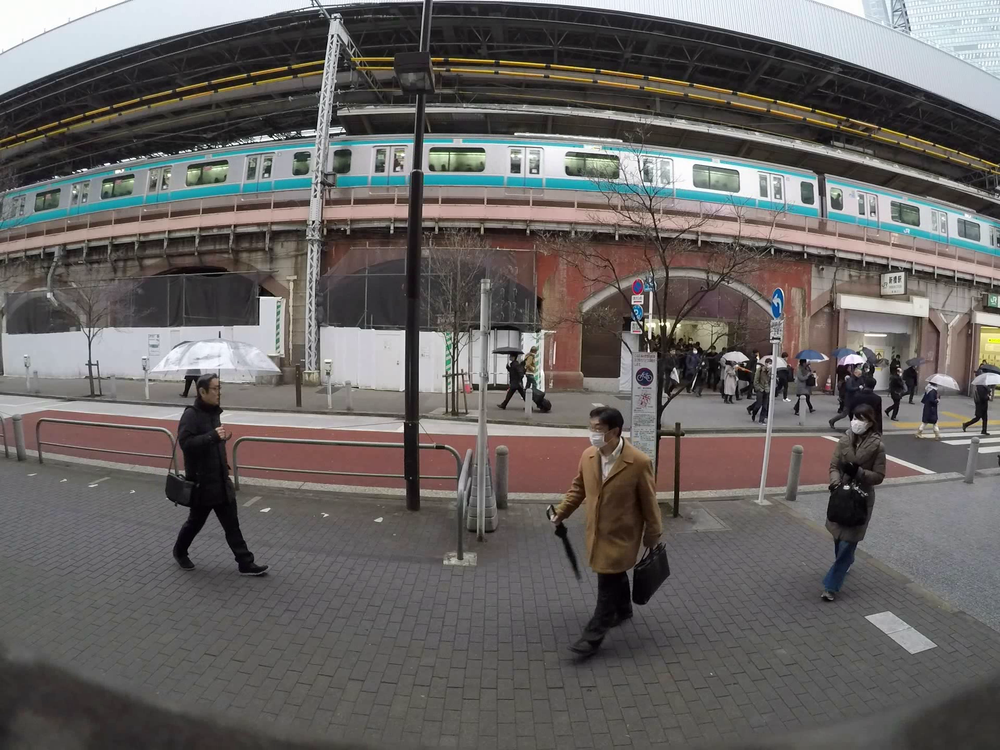

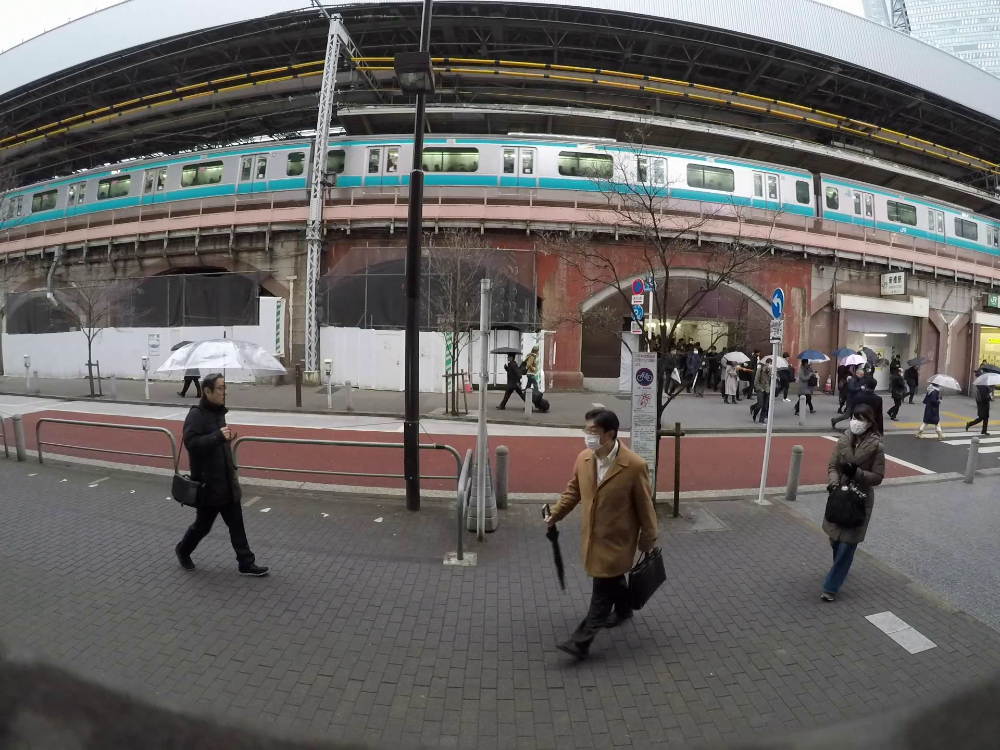

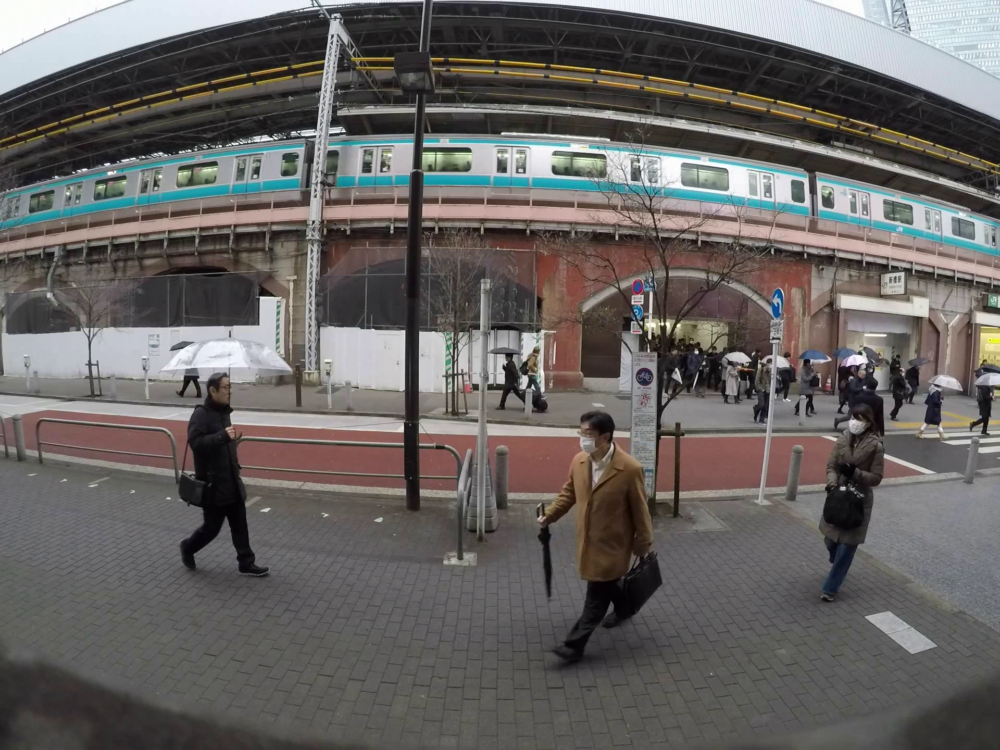

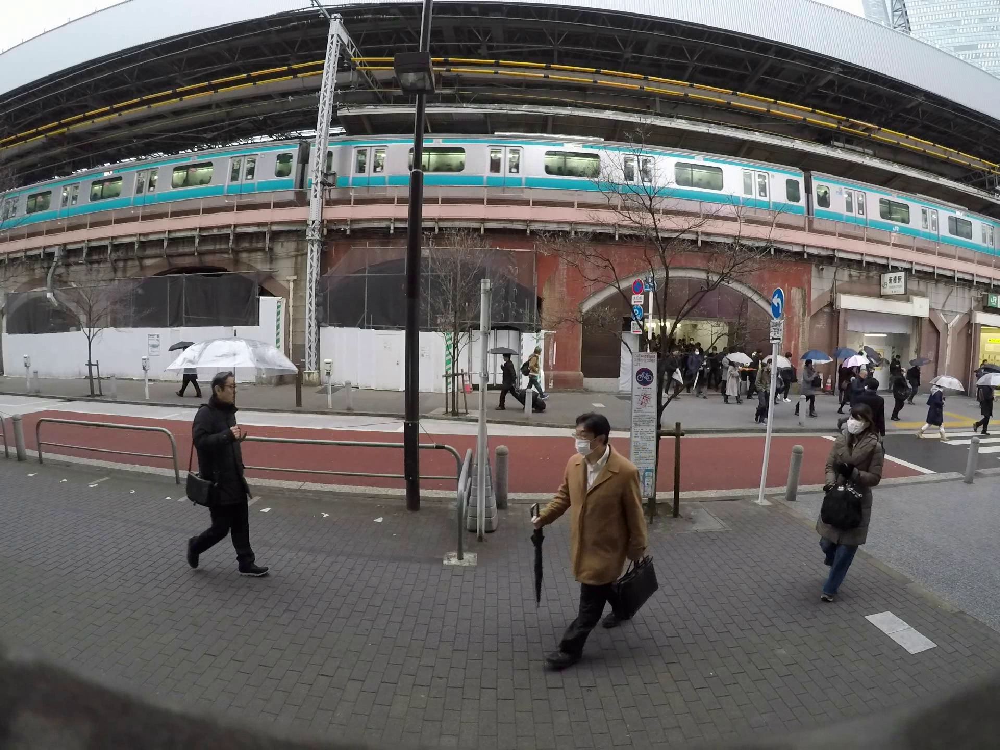

In [ ]:
# 情報取得
cap = cv2.VideoCapture('mov01.avi')
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
fps = cap.get(cv2.CAP_PROP_FPS)
print('画像幅：' + str(width))
print('画像高さ：' + str(height))
print('総フレーム数：' + str(count))
print('FPS：' + str(fps))

# 出力
while (cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        cv2_imshow(frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

### ノック83 映像を画像に分割し、保存してみよう

In [ ]:
# 情報取得
cap = cv2.VideoCapture('mov01.avi')
num = 0
# 出力
while (cap.isOpened()):
    ret, frame = cap.read()
    if ret:
        cv2_imshow(frame)
        filepath = 'snapshot/snapshpt_' + str(num) + '.jpg'
        cv2.imwrite(filepath, frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    num += 1
cap.release()
cv2.destroyAllWindows()

### ノック84：画像内のどこに人がいるのか検出してみよう

In [ ]:
# 準備
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())
hogParams = {'winStride':(8, 8), 'padding': (32, 32), 'scale':1.05, 'hitThreshold':0, 'finelThereshold':5}

# 検出
img = cv2.imread('img01.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
human, r = hog.detectMultiScale(gray, **hogParams)
if (len(human) > 0):
    for (x, y, w, h) in human:
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 255, 255), 3)
cv2._mshow(img)
cv2.waitKey(0)

### ノック85：画像内の人の顔を検出してみよう

In [ ]:
# 準備
cascade_file = 'haarcascade_frontalface_alt.xml'
cascade = cv2.CascadeClassifier(cascade_file)

# 検出
img = cv2.imread('img02.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
face_list = cascade.detectMultiScale(gray, minSize=(50, 50))

# 検出した顔に印をつける
for (x, y, w, h) in face_list:
    color = (0, 0, 255)
    pen_w = 3
    cv2.rectangle(img, (x, y), (x+w, y+h), color, thickness=pen_w)

cv2_imshow(img)
cv2.imwrite('temp.jpg', img)
cv2.waitKey(0)

### ノック86：画像内の人がどこに顔を向けているのかを検出してみよう

In [ ]:
import dlib
import math

# 準備
predictor = dlib.shape_predictor('shape_predictor_68_face_landmarks.dat')
detector = dlib.get_frontal_face_detector()

# 検出
img = cv2.imread('img02.jpg')
dets = detector(img, 1)

for k, d, in enumerate(dets):
    shape = predictor(img, d)

    # 顔領域の表示
    color_f = (0, 0, 225)
    color_l_out = (255, 0, 0)
    color_l_in = (0, 255, 0)
    line_w = 3
    circle_r = 3
    fontType = cv2.FONT_HERSHEY_SIMPLEX
    fontSize = 1

    cv2.rectangle(img, (d.left(), d.top()), (d.right(), d.bottom()), color_f, line_w)
    cv2.putText(img, str(k), (d.left(), d.top()), fontType, fontSize, color_f, line_w)

    # 重心を導出する箱を用意
    num_of_points_out = 17
    num_of_points_in = shape.num_parts - num_of_points_out
    gx_out = 0
    gy_out = 0
    gx_in = 0
    gy_in = 0
    for shape_point_count in range(shape.num_parts):
        shape_point = shape.part(shape_point_count)
        # 器官ごとに描画
        if shape_point_count < num_of_points_out:
            cv2.circle(img, (shape_point.x, shape_point.y), circle_r, color_l_out, line_w)
            gx_out = gx_out + shape_point.x / num_of_points_out
            gy_out = gy_out + shape_point.y / num_of_points_out
        else:
            cv2.circle(img, (shape_point.x, shape_point.y), circle_r, color_l_in, line_w)
            gx_in = gx_in + shape_point.x / num_of_points_in
            gy_in = gy_in + shape_point.y / num_of_points_in
    
    # 重心位置を描画
    cv2.circle(img, (int(gx_out), int(gy_out)), circle_r, (0, 0, 255), line_w)
    cv2.circle(img, (int(gx_in), int(gy_in)), circle_r, (0, 0, 0), line_w)

    # 顔の方位を計算
    theta = math.asin(2 * (gx_in - gx_out) / (d.right() - d.left()))
    radian = theta * 180 / math.pi
    print('顔方位：{}（角度：{}）'.format(theta, radian))

    # 顔方位を表示
    if radian < 0:
        textPrefix = 'left'
    else:
        textPrefix = 'right'
    textShow = textPrefix + str(round(abs(radian), 1)) + 'deg'
    cv2.putText(img, textShow, (d.left(), d.top()), fontType, fontSize, color_f, line_w)

cv2_imshow(img)
cv2.imwrite('temp.jpg', img)
cv2.waitKey

### ノック87：検出した情報を統合し、タイムプラスを作ってみよう

In [ ]:
movie = 'timelapse.avi'
fourcc = cv2.VideoWriter_fourcc('X', 'V', 'I', 'D')
video = cv2.VideoWrite(movie_name, fourcc, 30, (Width, Height))

video.write(frame)
video.release()

### ノック88：全体像をグラフにして可視化してみよう

In [ ]:
import pandas as pd
list_df = pd.DataFrame(columns=['time', 'people'])

tmp_se = pd.Series([num / fps, len(human)], index=list_df.columns)
list_df = list_df.append(tmp_se, ignore_index=True)

import matplotlib.pyplot as plt
plt.plot(list_df['time'], list_df['people'], label='test')
plt.show()

### ノック89：人通りの変化をグラフで確認しよう

In [ ]:
cap = cv2.VideoCapture('mov02.avi')

### ノック90：移動平均を計算することでノイズの影響を除去しよう

In [ ]:
def movie_average(x, y):
    y_conv = np.convolve(y, np.ones(5) / float(5), mode='valid')
    x_dat = np.linspace(np.min(x), np.max(x), np.size(y_conv))
    return x_dat, y_conv